# Image Preprocessing Analysis

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import cv2
import math

In [2]:
df = pd.read_csv('../../data/metadata.csv')
df

,patient_id,lesion_id,smoke,drink,background_father,background_mother,age,pesticide,gender,skin_cancer_history,...,diameter_2,diagnostic,itch,grew,hurt,changed,bleed,elevation,img_id,biopsed
0,PAT_1516,1765,NaN,NaN,NaN,NaN,8,NaN,NaN,NaN,...,NaN,NEV,False,False,False,False,False,False,PAT_1516_1765_530.png,False
1,PAT_46,881,False,False,POMERANIA,POMERANIA,55,False,FEMALE,True,...,5.0,BCC,True,True,False,True,True,True,PAT_46_881_939.png,True
2,PAT_1545,1867,NaN,NaN,NaN,NaN,77,NaN,NaN,NaN,...,NaN,ACK,True,False,False,False,False,False,PAT_1545_1867_547.png,False
3,PAT_1989,4061,NaN,NaN,NaN,NaN,75,NaN,NaN,NaN,...,NaN,ACK,True,False,False,False,False,False,PAT_1989_4061_934.png,False
4,PAT_684,1302,False,True,POMERANIA,POMERANIA,79,False,MALE,True,...,5.0,BCC,True,True,False,False,True,True,PAT_684_1302_588.png,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2293,PAT_1708,3156,NaN,NaN,NaN,NaN,73,NaN,NaN,NaN,...,NaN,ACK,True,False,False,False,False,False,PAT_1708_3156_175.png,False
2294,PAT_46,880,False,False,POMERANIA,POMERANIA,55,False,FEMALE,True,...,12.0,BCC,True,True,False,True,False,False,PAT_46_880_140.png,True
2295,PAT_1343,1217,NaN,NaN,NaN,NaN,74,NaN,NaN,NaN,...,NaN,SEK,False,False,False,False,False,False,PAT_1343_1217_404.png,False
2296,PAT_326,690,False,False,POMERANIA,POMERANIA,58,True,FEMALE,True,...,4.0,BCC,True,False,False,False,False,True,PAT_326_690_823.png,True


In [3]:
df_melanoma = df[df["diagnostic"] == "MEL"]
df_melanoma

,patient_id,lesion_id,smoke,drink,background_father,background_mother,age,pesticide,gender,skin_cancer_history,...,diameter_2,diagnostic,itch,grew,hurt,changed,bleed,elevation,img_id,biopsed
53,PAT_680,1289,True,False,PORTUGAL,ITALY,78,False,MALE,True,...,10.0,MEL,False,True,False,True,False,True,PAT_680_1289_182.png,True
86,PAT_995,1867,False,False,UNK,UNK,49,False,FEMALE,False,...,20.0,MEL,False,True,False,True,False,True,PAT_995_1867_5.png,True
112,PAT_966,1825,False,False,POMERANIA,POMERANIA,46,False,FEMALE,False,...,5.0,MEL,True,True,False,True,False,False,PAT_966_1825_584.png,True
164,PAT_966,1825,False,False,POMERANIA,POMERANIA,46,False,FEMALE,False,...,5.0,MEL,True,True,False,True,False,False,PAT_966_1825_546.png,True
262,PAT_495,941,False,False,POMERANIA,POMERANIA,58,True,MALE,False,...,11.0,MEL,False,UNK,False,True,False,False,PAT_495_941_26.png,True
266,PAT_614,1166,False,False,UNK,UNK,56,False,FEMALE,False,...,6.0,MEL,False,True,False,True,False,False,PAT_614_1166_885.png,True
281,PAT_340,714,False,True,ITALY,ITALY,54,False,FEMALE,False,...,12.0,MEL,True,True,False,True,False,True,PAT_340_714_68.png,True
296,PAT_115,1138,False,False,POMERANIA,POMERANIA,70,False,MALE,False,...,8.0,MEL,False,True,False,True,False,True,PAT_115_1138_870.png,True
338,PAT_895,1699,False,False,GERMANY,PORTUGAL,65,False,FEMALE,False,...,10.0,MEL,False,UNK,False,UNK,False,False,PAT_895_1699_872.png,True
412,PAT_233,354,False,False,POMERANIA,POMERANIA,58,True,FEMALE,True,...,4.0,MEL,False,True,False,True,False,True,PAT_233_354_935.png,True


## Sample images from the original dataset

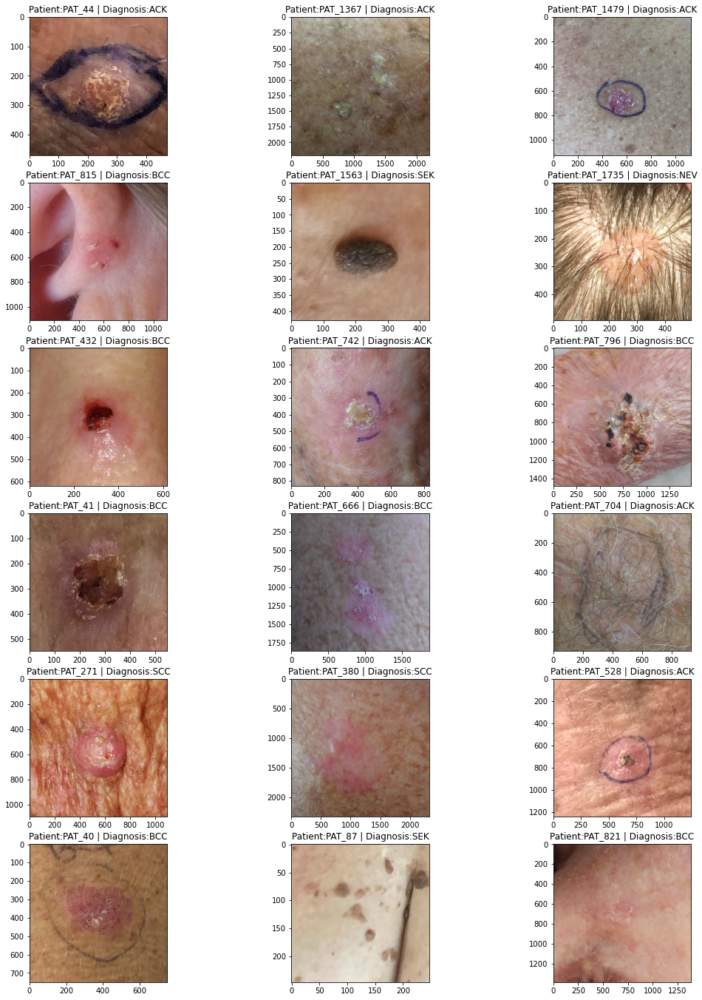

In [4]:
def show_sample_pictures(df: pd.DataFrame, n_samples=9):
    microdf = df.sample(n_samples).reset_index()
    imgs = microdf['img_id'].to_list()
    diganosis = microdf['diagnostic'].to_list()
    patients = microdf['patient_id'].to_list()
    fig = plt.figure(figsize=(18,3*((n_samples+6)//3)))
    axList = []
    for i in range(n_samples):
        axList.append(fig.add_subplot((2+n_samples)//3,3,i+1))
        filename = '../../data/images/'+imgs[i]
        img = cv2.imread(filename)[:,:,::-1]
        axList[i].imshow(img)
        axList[i].set_title("Patient:{0} | Diagnosis:{1}".format(patients[i], diganosis[i]))

diseases = df['diagnostic'].unique()

show_sample_pictures(df, 18)

In [5]:
diseases

array(['NEV', 'BCC', 'ACK', 'SEK', 'SCC', 'MEL'], dtype=object)

# Image processing

In [6]:
# Função para detectar contornos (Canny)
def auto_canny(image, sigma=0.33):
    v = np.median(image)
    lower = int(max(0, (1.0 - sigma) * v))
    upper = int(min(255, (1.0 + sigma) * v))
    edged = cv2.Canny(image, lower, upper)
    return edged

In [7]:
# Função para aplicar um equalizador de histograma adaptativo (CLAHE)
def adaptive_histeq(img_gray):
      clahe = cv2.createCLAHE(clipLimit = 2.0, tileGridSize=(8,8))
      final_img = clahe.apply(img_gray) 
      return final_img

In [8]:
# Função para mostrar várias imagens em forma de uma grade
def image_grid(images, cols = 4):
    n_images = len(images)
    fig = plt.figure()
    for n, (image) in enumerate(images):
        a = fig.add_subplot(int(cols), int(np.ceil(n_images/float(cols))), n + 1)
        if image.ndim == 2:
            plt.gray()
        plt.imshow(image)
    fig.set_size_inches(np.array(fig.get_size_inches()) * n_images)
    plt.show()

In [9]:
def simple_processing_clahe(img):
    
    gray = cv2.imread(filename, cv2.IMREAD_GRAYSCALE)
    kernel = cv2.getStructuringElement(1,(7,7))
    closing = cv2.morphologyEx(gray,cv2.MORPH_CLOSE,kernel, iterations = 2)
    imgeq = cv2.equalizeHist(gray)
    clahe=adaptive_histeq(gray)
    
    return clahe
    

In [55]:
def apply_processing_show_sample_pictures(df: pd.DataFrame, func, n_samples=9):
    microdf = df.sample(n_samples, random_state=42).reset_index()
    imgs = microdf['img_id'].to_list()
    diganosis = microdf['diagnostic'].to_list()
    patients = microdf['patient_id'].to_list()
    fig = plt.figure(figsize=(18,3*((n_samples+6)//3)))
    axList = []
    for i in range(n_samples):
        axList.append(fig.add_subplot((2+n_samples)//3,3,i+1))
        filename = '../../data/images/'+imgs[i]
        img = cv2.imread(filename)[:,:,::-1]
        
        processed = func(img)
        axList[i].imshow(processed)
        axList[i].set_title("Patient:{0} | Diagnosis:{1}".format(patients[i], diganosis[i]))


## Simple preprocessing
* Closing and adaptive histogram equalization

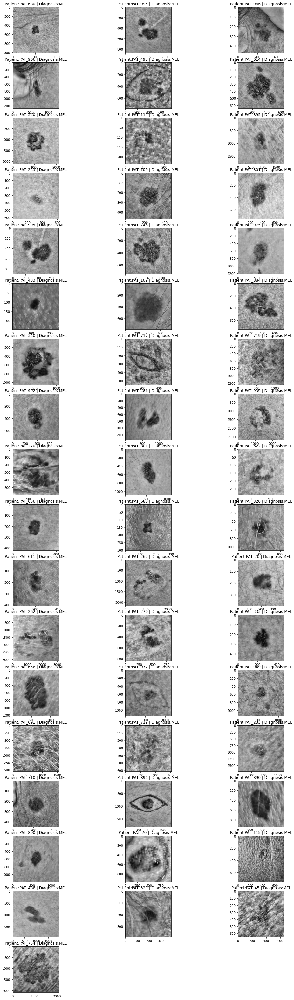

In [11]:
## Test simple preprocessing

n_samples=52 #df_melanoma.shape[0]
imgs = df_melanoma['img_id'].to_list()
diganosis = df_melanoma['diagnostic'].to_list()
patients = df_melanoma['patient_id'].to_list()
fig = plt.figure(figsize=(18,3*((n_samples+6)//3)))
axList = []
for i in range(n_samples):
    axList.append(fig.add_subplot((2+n_samples)//3,3,i+1))
    filename = '../../data/images/'+imgs[i]
    img = cv2.imread(filename)[:,:,::-1]
    clahe = simple_processing_clahe(img)

    axList[i].imshow(clahe, cmap='gray', vmin = 0, vmax = 255)
    #axList[i].imshow(imgeq)
    axList[i].set_title("Patient:{0} | Diagnosis:{1}".format(patients[i], diganosis[i]))



# Testing different color spaces

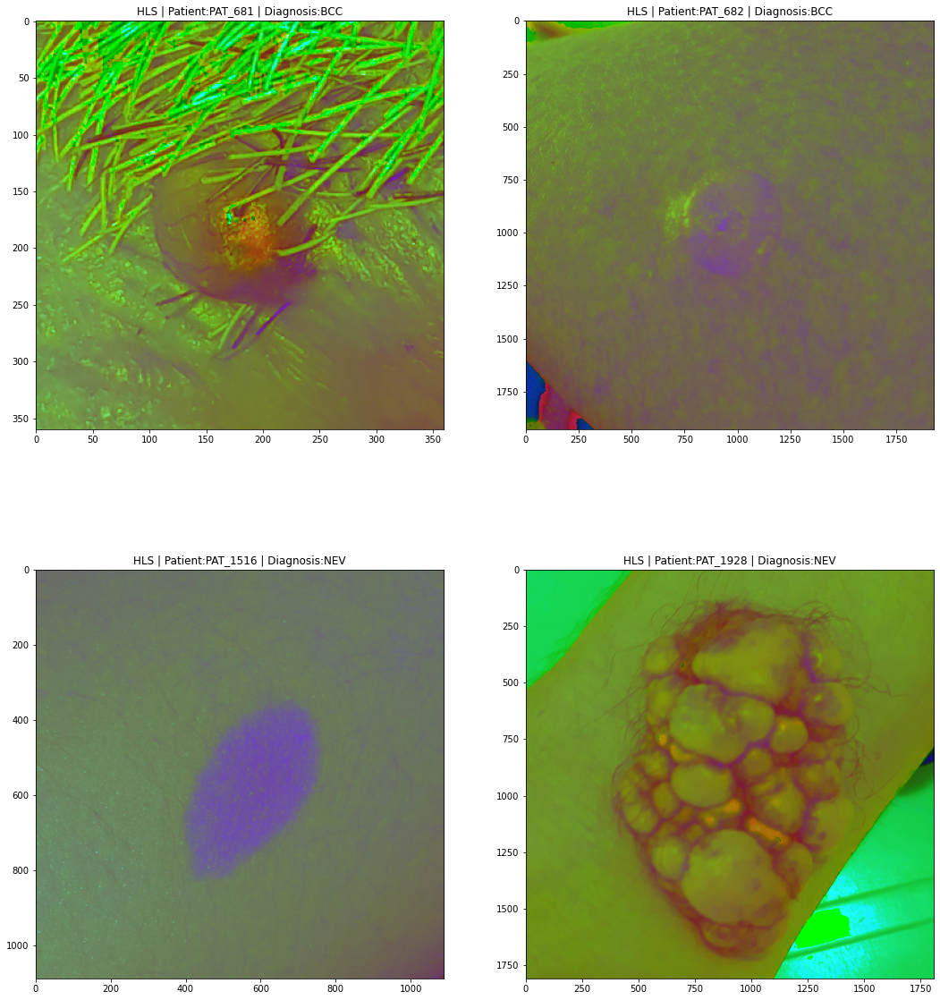

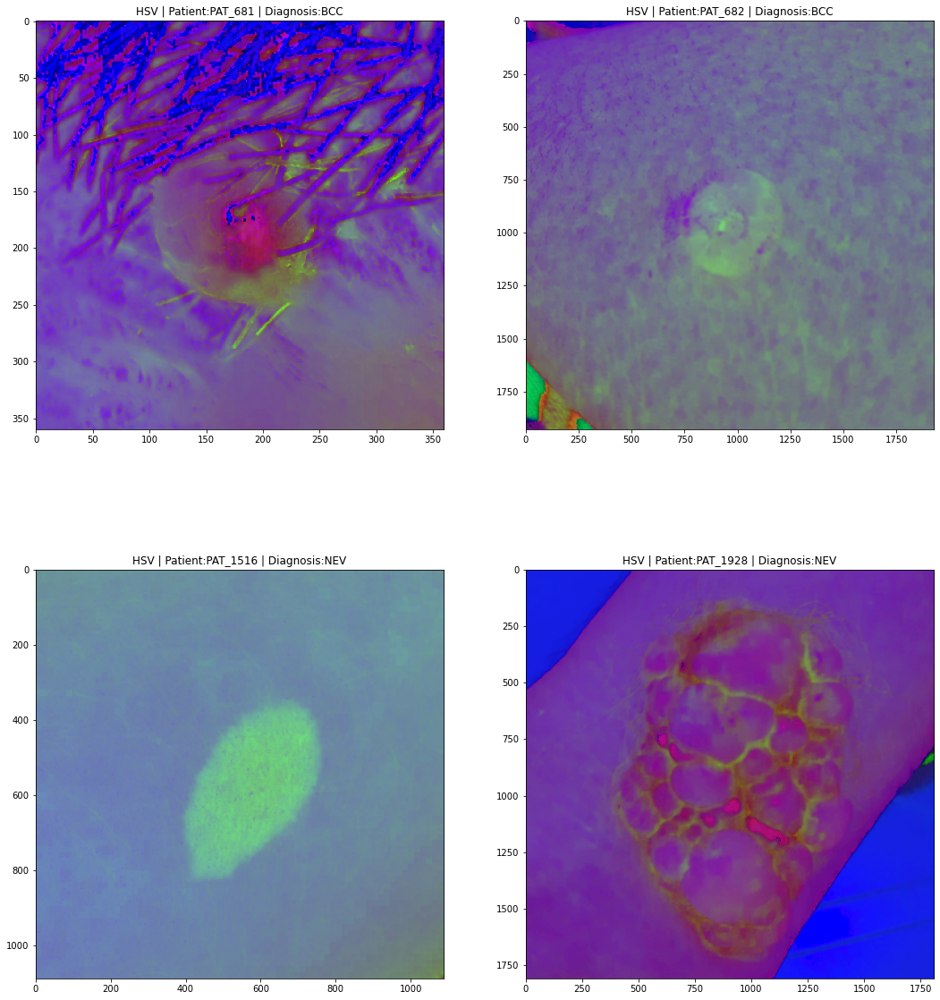

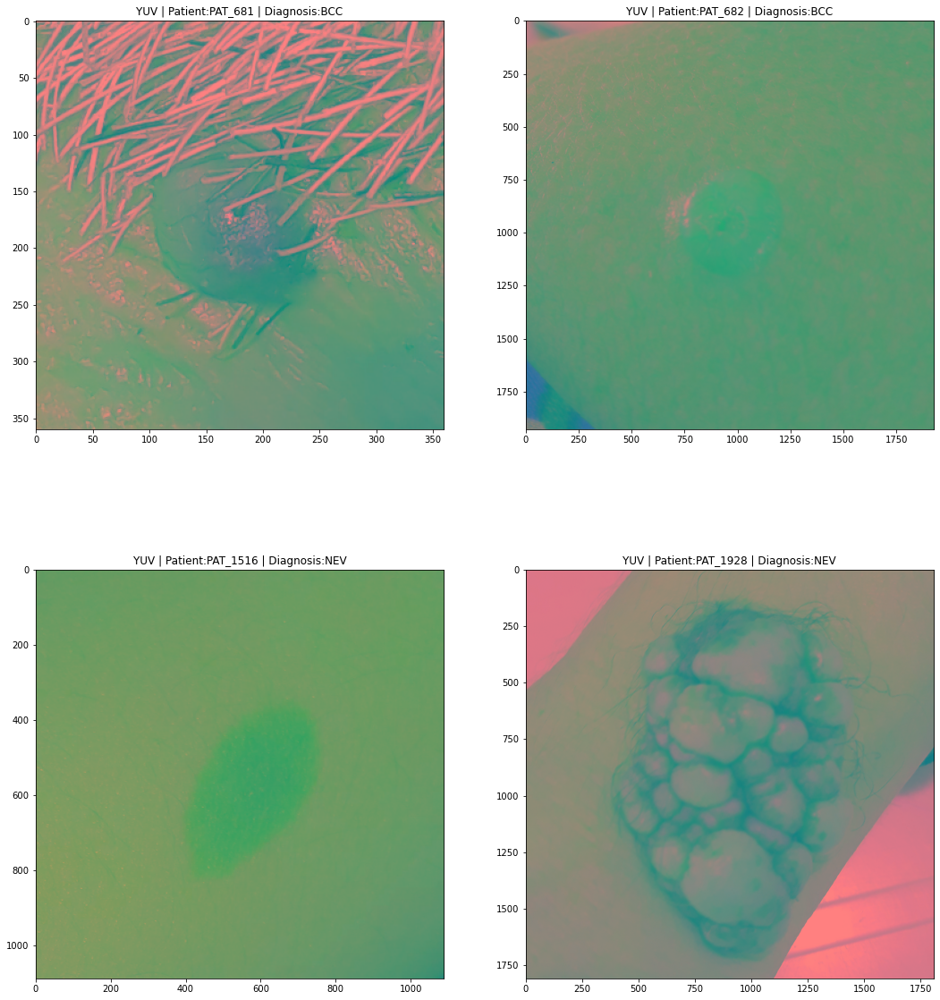

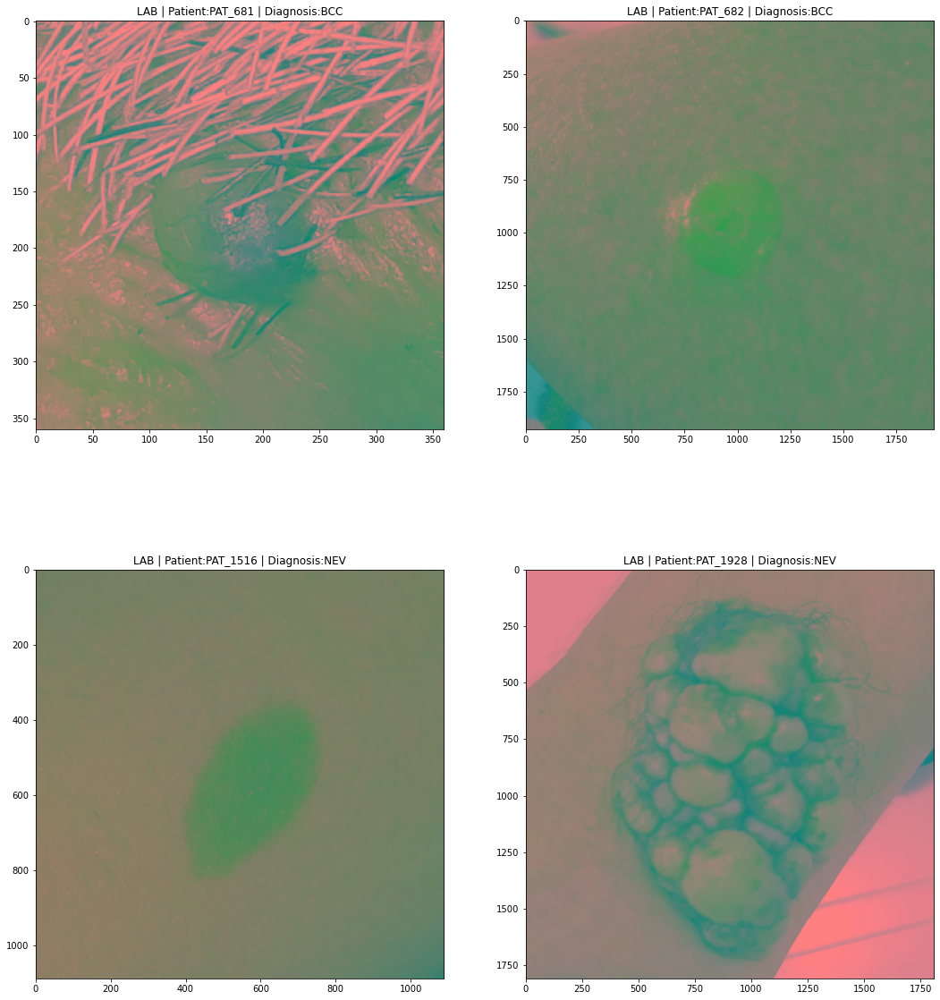

In [12]:
 def test_color_spaces(df: pd.DataFrame, n_samples=9):
    microdf = df.sample(n_samples).reset_index()
    imgs = microdf['img_id'].to_list()
    diganosis = microdf['diagnostic'].to_list()
    patients = microdf['patient_id'].to_list()
    fig = plt.figure(figsize=(18,8*((n_samples+4)//2)))
    fig2 = plt.figure(figsize=(18,8*((n_samples+4)//2)))
    fig3 = plt.figure(figsize=(18,8*((n_samples+4)//2)))
    fig4 = plt.figure(figsize=(18,8*((n_samples+4)//2)))

    axList_hls = []
    axList_hsv = []
    axList_yuv = []
    axList_lab = []
    for i in range(n_samples):
        axList_hls.append(fig.add_subplot((2+n_samples)//2,2,i+1))
        axList_hsv.append(fig2.add_subplot((2+n_samples)//2,2,i+1))
        axList_yuv.append(fig3.add_subplot((2+n_samples)//2,2,i+1))
        axList_lab.append(fig4.add_subplot((2+n_samples)//2,2,i+1))

        filename = '../../data/images/'+imgs[i]
        img = cv2.imread(filename)[:,:,::-1]
        
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
                
        hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
        
        hls = cv2.cvtColor(img, cv2.COLOR_BGR2HLS)
        
        yuv = cv2.cvtColor(img, cv2.COLOR_BGR2YUV)
                
        lab= cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
       
        axList_hsv[i].imshow(hsv, cmap='gray', vmin = 0, vmax = 255)
        axList_hsv[i].set_title("HSV | Patient:{0} | Diagnosis:{1}".format(patients[i], diganosis[i]))

        axList_lab[i].imshow(lab, cmap='gray', vmin = 0, vmax = 255)
        axList_lab[i].set_title("LAB | Patient:{0} | Diagnosis:{1}".format(patients[i], diganosis[i]))

        axList_hls[i].imshow(hls, cmap='gray', vmin = 0, vmax = 255)
        axList_hls[i].set_title("HLS | Patient:{0} | Diagnosis:{1}".format(patients[i], diganosis[i]))

        axList_yuv[i].imshow(yuv, cmap='gray', vmin = 0, vmax = 255)
        axList_yuv[i].set_title("YUV | Patient:{0} | Diagnosis:{1}".format(patients[i], diganosis[i]))
        

test_color_spaces(df, 4)

# Melanoma Skin Cancer Detection Method Based on Adaptive Principal Curvature, Colour Normalisation and Feature Extraction with the ABCD Rule

https://www.ncbi.nlm.nih.gov/pmc/articles/PMC7256173/pdf/10278_2019_Article_316.pdf


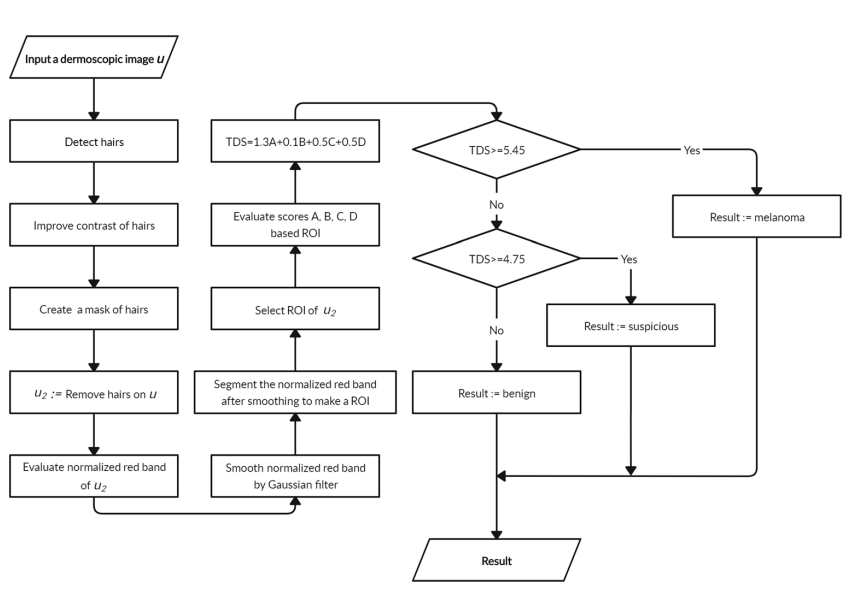

1. Detect hairs by the adaptive principal curvatures.
    	- Improve contrast of the detected hairs.
        - Segment hairs to make the hairs mask in the form of a black-white image.
        - Remove hairs from skin lesions image by the inpainting method with above hairs mask.
2. Calculate the normalized red band of the dermoscopic skin lesions image after removing hairs.
3. Apply the Gaussian kernel to smooth the normalized red band.
4. Segment the skin lesions by the thresholding method with the global threshold calculated by the Otsu method to make an ROI (region of interest).
5. From the segmented regions of the skin lesions, calculate the asymmetry score , the  border score , the colour score and the diameter score .
    - Calculate score = 1.3 + 0.1 + 0.5 + 0.5 .
    - Check conditions:
            If ≥ 5.45: = The melanoma skin cancer is detected.
            If 4.75 ≤ < 5.45: = Suspicious case.
            If < 4.75: = Benign case.


### Colours
To determine the colour score, it is necessary to consider the following colours: white, red, light brown, dark
brown, blue-grey and black. The light and dark brown
reflect melanin localised mainly in the epidermis and/or
superficial dermis; the black represents melanin in the
upper granular layer, stratum corneum or all layers of
the epidermis; the blue-grey is for melanin in the papillary
dermis, and the white corresponds to areas of regression;
and the red reflects the degree of inflammation or neovascularization. If there is a presence of one from the above
colours, the colour score will be increased by 1. The maximum colour score is 6 and the minimum colour score is 1. The impact factor of the colour score in the TDS score
is c = 0.5.

Our goal for the skin lesions segmentation focuses on
the RGB-colour model. However, we need to normalise
the colour channels before calculating the image threshold to apply the thresholding segmentation. Because the
skin tone and colours of the skin lesions usually depend
on the red channel more than the green and the blue
channels, we normalised the red band of the RGBcolour model



### Border
The border score is evaluated upon whether there is a
sharp, abrupt cut-off of pigment pattern at the periphery
of the skin lesions or a gradual, indistinct cut-off. By
this way, the lesions are divided into eight parts. The
border score is the number of parts, whether there is a sharp or gradual cut-off. The minimum border score is 0
and the maximum border score is 8. The impact factor
of the border score in the TDS score is b = 0.1.


### Asymmetry
The asymmetry score of skin lesion is evaluated based
on both the contour asymmetry and the asymmetry of the
distribution of dermoscopic colours and structures. The
asymmetry needs to be evaluated on either side of each
axis for the colours and structures and the contour of the
lesions. If there is no asymmetry in any axes, the asymmetry score is 0. If there is asymmetry by one axis, the
asymmetry score is 1. In the case of asymmetry by both
axes, the asymmetry score is 2. The impact factor of the
asymmetry score in the TDS score is a = 1.3.



## Removing hairs

In [13]:
# Hand-picked images containing hairs
hair_ids = ["PAT_691", "PAT_320", "PAT_109", "PAT_356", "PAT_681", "PAT_167", "PAT_2109", "PAT_245", "PAT_633"]

In [14]:
df_hair_test = df[df["patient_id"].isin(hair_ids)]
df_hair_test

,patient_id,lesion_id,smoke,drink,background_father,background_mother,age,pesticide,gender,skin_cancer_history,...,diameter_2,diagnostic,itch,grew,hurt,changed,bleed,elevation,img_id,biopsed
170,PAT_691,1311,False,True,POMERANIA,GERMANY,56,True,MALE,False,...,15.0,BCC,False,False,False,True,False,True,PAT_691_1311_686.png,True
201,PAT_167,258,False,False,GERMANY,GERMANY,58,True,MALE,True,...,7.0,BCC,True,True,True,True,True,True,PAT_167_258_711.png,True
274,PAT_691,3994,False,True,POMERANIA,GERMANY,56,True,MALE,False,...,10.0,ACK,False,False,False,True,False,True,PAT_691_3994_671.png,False
434,PAT_109,868,True,True,ITALY,ITALY,82,True,MALE,False,...,6.0,MEL,False,True,False,True,False,False,PAT_109_868_723.png,True
447,PAT_691,1310,False,True,POMERANIA,GERMANY,56,True,MALE,False,...,15.0,BCC,True,UNK,True,UNK,True,True,PAT_691_1310_780.png,True
661,PAT_356,736,False,True,GERMANY,UNK,58,True,MALE,True,...,12.0,BCC,True,True,False,True,False,True,PAT_356_736_188.png,True
739,PAT_356,735,False,True,GERMANY,UNK,58,True,MALE,True,...,10.0,BCC,True,True,True,False,True,True,PAT_356_735_568.png,True
740,PAT_109,868,True,True,ITALY,ITALY,82,True,MALE,False,...,6.0,MEL,False,True,False,True,False,False,PAT_109_868_113.png,True
851,PAT_356,4511,False,True,GERMANY,NaN,68,True,MALE,True,...,12.0,ACK,True,False,False,False,True,False,PAT_356_4511_960.png,False
858,PAT_691,1311,False,True,POMERANIA,GERMANY,56,True,MALE,False,...,15.0,BCC,False,False,False,True,False,True,PAT_691_1311_2.png,True


In [15]:
# https://github.com/sunnyshah2894/DigitalHairRemoval

def remove_hairs(img):
    kernel = cv2.getStructuringElement(1,(17,17))
    grayScale = cv2.cvtColor( img, cv2.COLOR_RGB2GRAY )
    edges = cv2.morphologyEx(grayScale, cv2.MORPH_BLACKHAT, kernel)
    ret,thresh = cv2.threshold(edges,10,255,cv2.THRESH_BINARY)
    dst = cv2.inpaint(img,thresh,1,cv2.INPAINT_TELEA)
    
    return edges, thresh, dst

In [16]:
def hair_removal_test(df, n_samples):
    microdf = df.sample(n_samples).reset_index()
    imgs = microdf['img_id'].to_list()
    diganosis = microdf['diagnostic'].to_list()
    patients = microdf['patient_id'].to_list()
    
    original_list = []
    hair_mask_list = []
    thresh_list = []
    hair_removed_list = []
    
    for i in range(n_samples):
        filename = '../../data/images/'+imgs[i]
        img = cv2.imread(filename)[:,:,::-1]
        
        edges, thresh, dst = remove_hairs(img)
                
        hair_mask_list.append(edges)
        thresh_list.append(thresh)
        hair_removed_list.append(dst)
        original_list.append(img)
        
    return original_list, hair_mask_list, thresh_list, hair_removed_list
        

original_list, hair_mask_list, thresh_list, hair_removed_list = hair_removal_test(df_hair_test, 6)

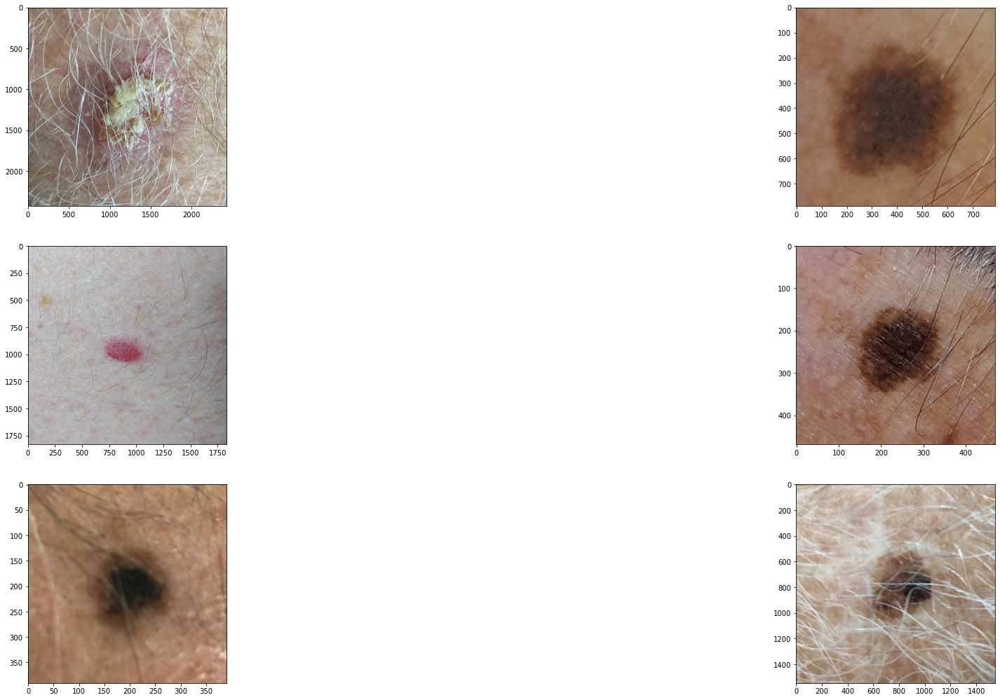

In [17]:
image_grid(original_list)

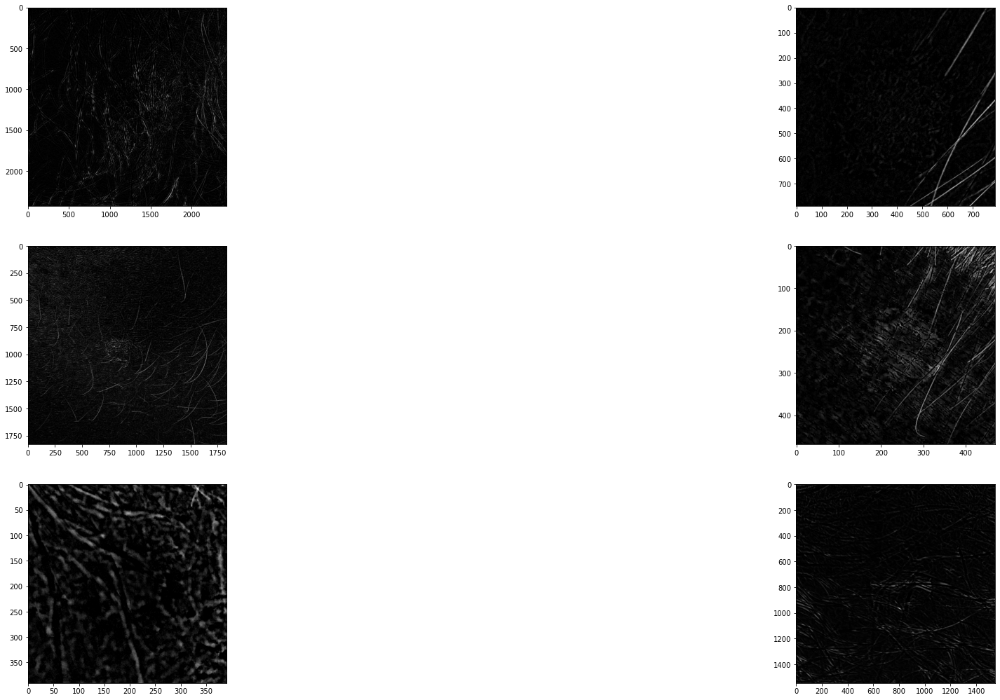

In [18]:
image_grid(hair_mask_list)

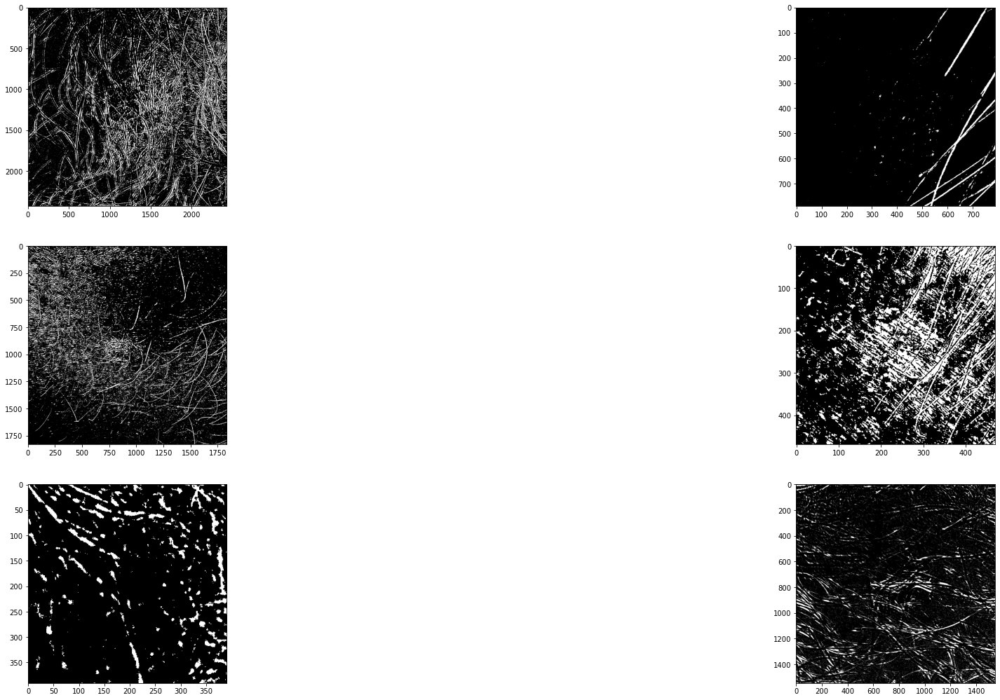

In [19]:
image_grid(thresh_list)

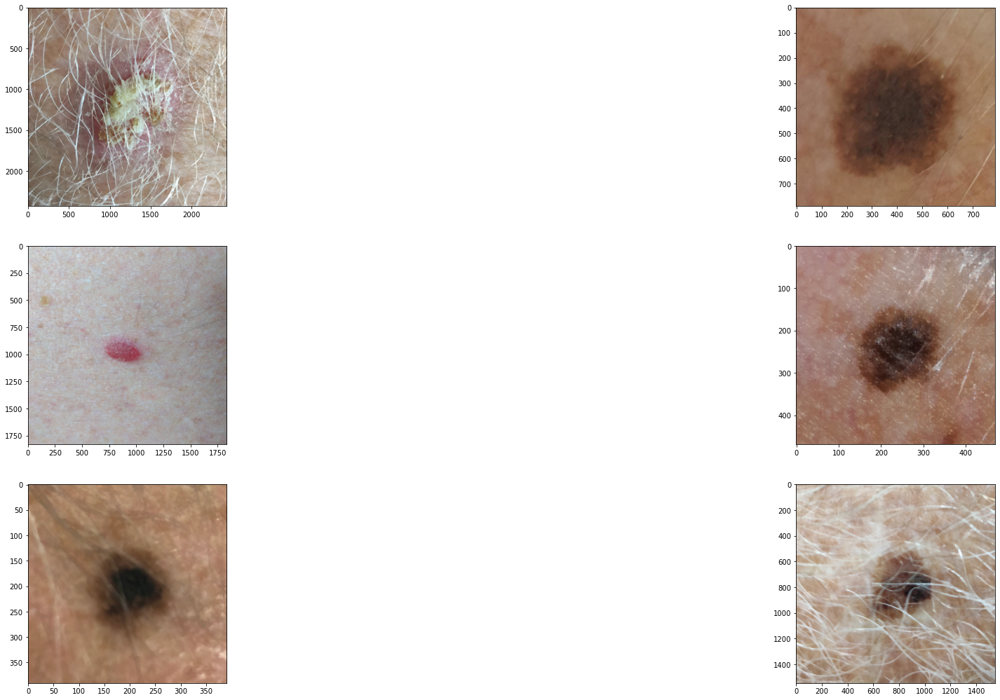

In [20]:
image_grid(hair_removed_list)

## Normalized red band

In [21]:
def normalize_red_band(img):
    blank_img = img
    linhas,colunas,channels=img.shape
    for l in range(linhas):
          for c in range(colunas):
                ur,ug,ub = img[l][c]
                norm = ur/math.sqrt(ur**2+ug**2+ub**2)
                blank_img[l][c] = (norm,ug,ub)
    
    return norm

In [22]:
def test_normalize_red_band(img):
        R, G, B = cv2.split(img)
        norm_img = np.zeros((800,800))
        final_img = cv2.normalize(R,  norm_img, 0, 255, cv2.NORM_MINMAX)
        return final_img

In [51]:
def test_normalize_red_band_histeq(img):
    img = test_normalize_red_band(img)
    #imgeq=cv2.equalizeHist(img)
   # gray = cv2.cvtColor( img, cv2.COLOR_RGB2GRAY )
    imgeq=adaptive_histeq(img)
    return imgeq

In [53]:
def test_normalize_red_band_histeq2(img):
    img = test_normalize_red_band(img)
    imgeq=cv2.equalizeHist(img)
   # gray = cv2.cvtColor( img, cv2.COLOR_RGB2GRAY )
    #imgeq=adaptive_histeq(img)
    return imgeq

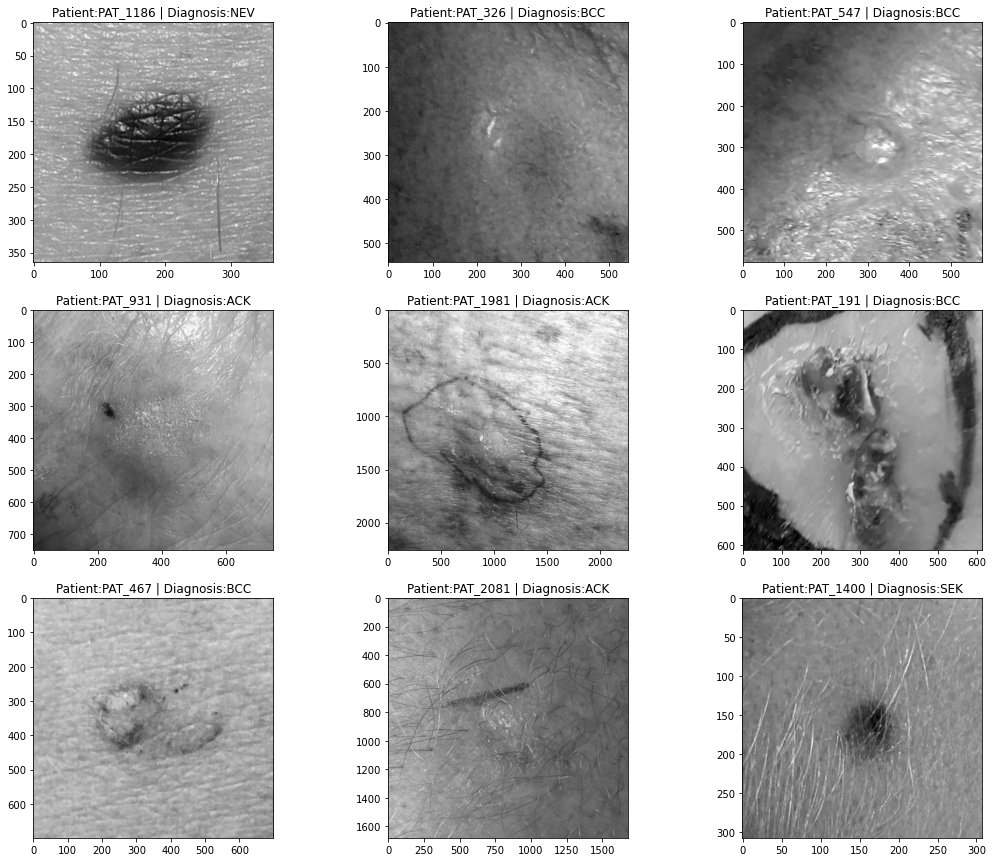

In [56]:
apply_processing_show_sample_pictures(df, test_normalize_red_band, n_samples=9)

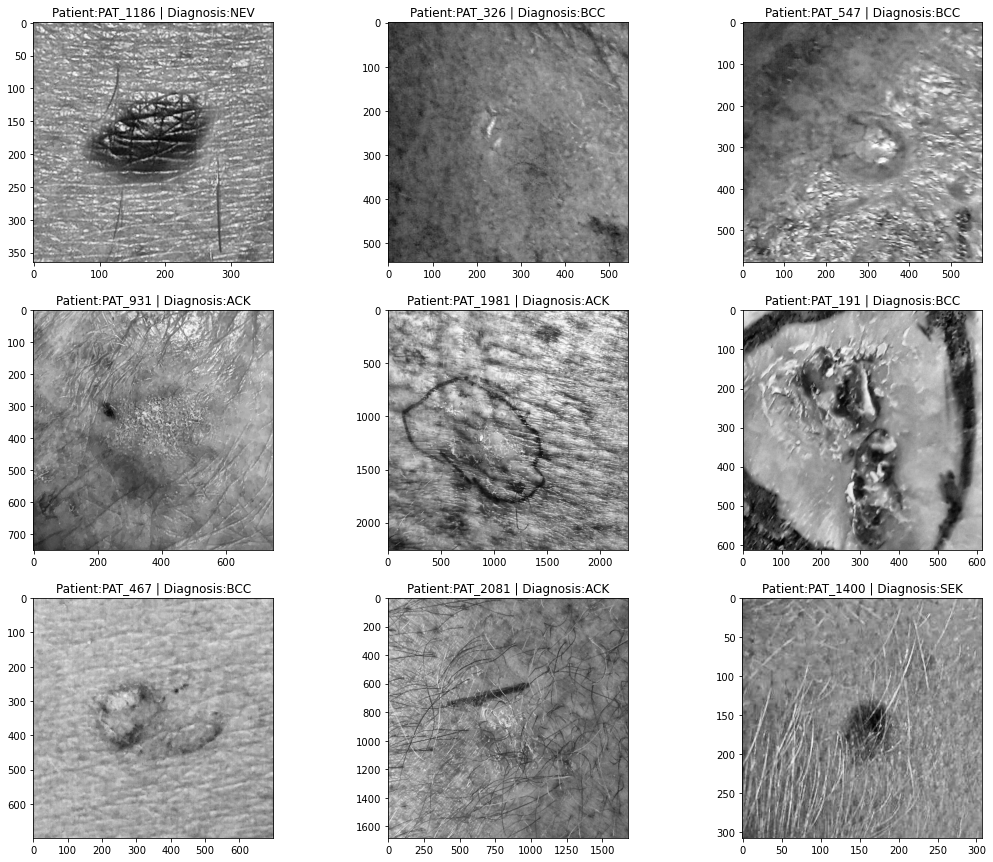

In [57]:
apply_processing_show_sample_pictures(df, test_normalize_red_band_histeq, n_samples=9)

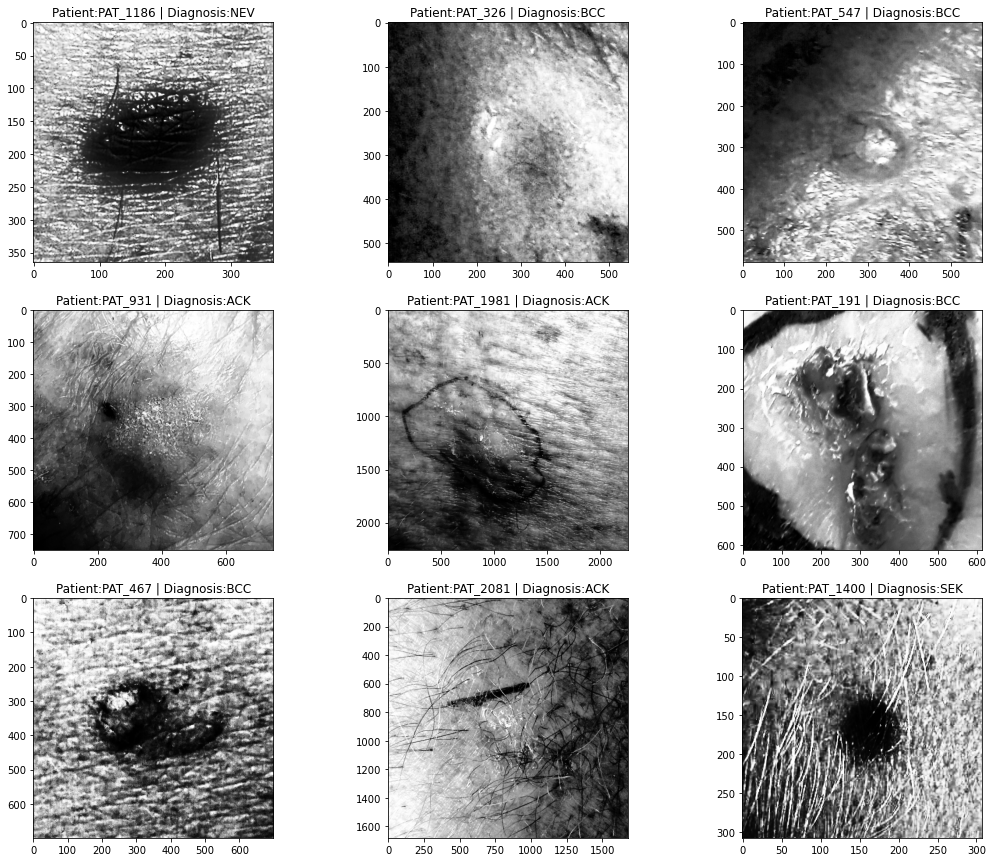

In [58]:
apply_processing_show_sample_pictures(df, test_normalize_red_band_histeq2, n_samples=9)

In [69]:
def test_article1(img):
        blank_img = img
        edges, thresh, dst = remove_hairs(img)
       # r_norm = test_normalize_red_band(dst)
        r_norm = test_normalize_red_band_histeq(img)
            
        imgeq=adaptive_histeq(r_norm)
   
        return r_norm

In [72]:
def test_article1_3(img):
        blank_img = img
        edges, thresh, dst = remove_hairs(img)
       # r_norm = test_normalize_red_band(dst)
        r_norm = test_normalize_red_band_histeq(img)      
        blur = cv2.GaussianBlur(r_norm,(13,13),0)        
        imgeq=adaptive_histeq(blur)
   
        return r_norm

In [59]:
def test_article1_2(img):
        blank_img = img
        edges, thresh, dst = remove_hairs(img)
        r_norm = test_normalize_red_band(dst)
        #r_norm = test_normalize_red_band_histeq(img)
   
        return r_norm

In [28]:
def image_test(imgs, func):
    n_samples=len(imgs)
    fig = plt.figure(figsize=(18,8*((n_samples+4)//2)))
    axList = []
    processed_imgs = []
    for i in range(n_samples):
        axList.append(fig.add_subplot((2+n_samples)//2,2,i+1))
        filename = '../../data/images/'+imgs[i]
        img = cv2.imread(filename)[:,:,::-1]
        
        processed = func(img)

        axList[i].imshow(processed, cmap='gray', vmin = 0, vmax = 255)
        
        processed_imgs.append(f"../../data/images/tests/test_{imgs[i]}")
        
    return processed_imgs

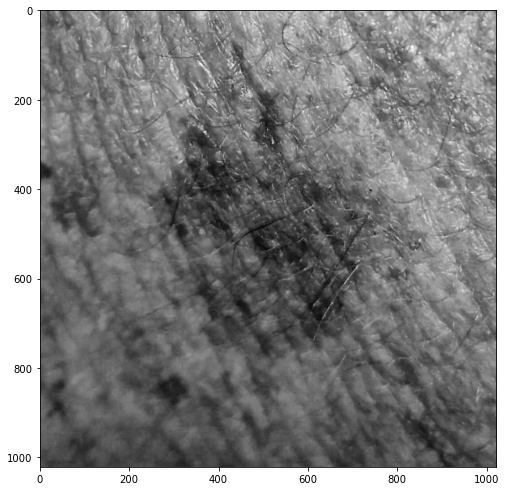

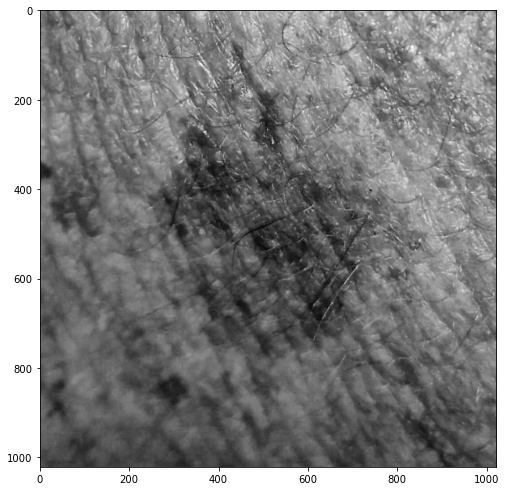

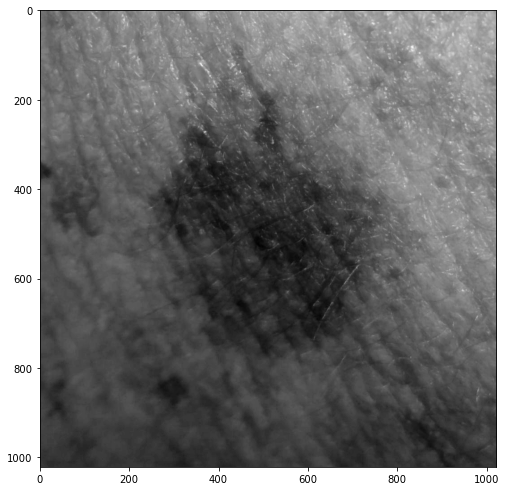

In [73]:
test_imgs = ["PAT_1577_3527_831.png"]
processed_imgs1 = image_test(test_imgs, test_article1)
processed_imgs1 = image_test(test_imgs, test_article1_3)
processed_imgs2 = image_test(test_imgs, test_article1_2)

## Feature extraction for melanoma identification

### Segment the skin lesions by the thresholding method 

In [30]:
def img_blur(img):
    img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(img,(11,11),0)
    return blur

In [31]:
def lesion_segmentation(img):
    blur = img_blur(img)
    T,imgt = cv2.threshold(blur,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)
    T,imgt3 = cv2.threshold(blur,np.median(blur),255,cv2.THRESH_BINARY)
    contours, hierarchy = cv2.findContours(imgt.astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)

    if len(contours) != 0:
            print("found")
            cv2.drawContours(blur, contours, -1, 255, 3)
            c = max(contours, key = cv2.contourArea)
            x,y,w,h = cv2.boundingRect(c)
    
    return imgt

found


['../../data/images/tests/test_../../data/images/tests/test_PAT_1577_3527_831.png']

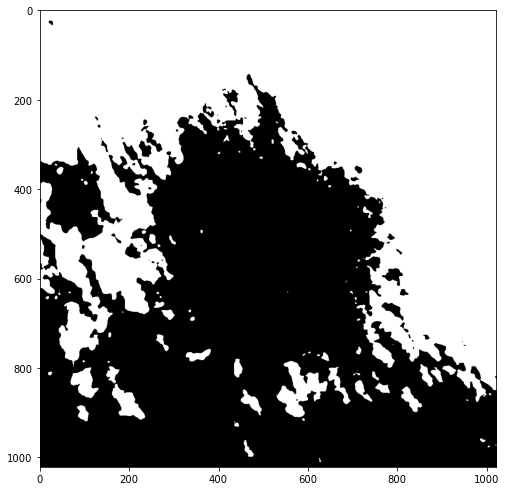

In [75]:
# image_test(processed_imgs1, img_blur)
image_test(processed_imgs1, lesion_segmentation)

found


['../../data/images/tests/test_../../data/images/tests/test_PAT_1577_3527_831.png']

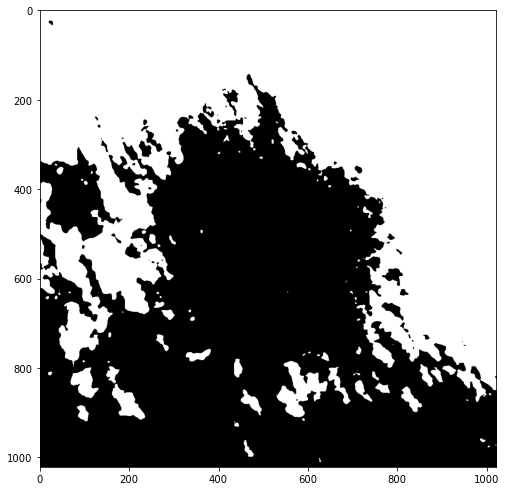

In [76]:
# image_test(processed_imgs2, img_blur)
image_test(processed_imgs2, lesion_segmentation)

https://www.faqcode4u.com/faq/416636/how-to-identify-if-the-shapes-of-an-image-are-symmetric-or-asymmetric-using-open

# Vision-Based Classification of Skin Cancer using Deep Learning
### Stanford University
https://web.stanford.edu/~kalouche/docs/Vision_Based_Classification_of_Skin_Cancer_using_Deep_Learning_(Kalouche).pdf

### Lesion Segmentation

1. After each image is loaded a light Gaussian kernel blur is applied to smoothen the edges and reduce the outline of any thin and light colored hairs present in the image. 
2. (Next, an algorithm runs to determine whether or not vignetting is present in the image. If vignetting is detected then a circle crop is applied to crop out the corners of the image so that a contrast filter can eventually be applied without increasing contrast in the corners which would lead the model into thinking skin lesions were present in the corners of the image. This crop was sized appropriately for each picture based on the image size and the strength of the vignette. For the most part, the images had the mole/lesion centrally located so cropping out the corners had near negligible effect.) 
3. Using built-in functions from Python’s OpenCV library the image’s contrast was then increased 
4. afterwards the image was converted to gray scale. OpenCV’s Canny edge detector was then applied to locate edges and find contours from those connected edges. 
5. The contours with the largest areas above a fine-tuned threshold were kept and the rest were discarded. This helped localize the actual mole while removing things like hair and freckles which are not considered as an area of interest. 
6. The algorithm then generates a normalized threshold based on the mean pixel value of each image and from that threshold a binary mask is created. The binary mask or filter is a matrix with the same size as the original image but only contains values of 0 and 1 such that when applied (multiplied) onto the original image yields an image that is the area of interest i.e. the skin lesion) and the surrounding skin and environment is all black. The image then is formatted for input to the learningmodels.


In [34]:
def preprocessing_enhance_thresh(img):
        
        
        # Step 3
        # https://stackoverflow.com/questions/39308030/how-do-i-increase-the-contrast-of-an-image-in-python-opencv
#         lab= cv2.cvtColor(blur, cv2.COLOR_BGR2LAB)
#         l_channel, a, b = cv2.split(lab)
#         clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
#         cl = clahe.apply(l_channel)
#         limg = cv2.merge((cl,a,b))
#         enhanced_img = cv2.cvtColor(limg, cv2.COLOR_LAB2BGR)

        enhanced_img = cv2.convertScaleAbs(blur, alpha=1.8, beta=10)

        # Step 4
        gray = cv2.cvtColor(enhanced_img, cv2.COLOR_BGR2GRAY )
        gray=cv2.equalizeHist(gray)
        edges = cv2.Canny(gray,0,255)
        
        edges_inverse = cv2.bitwise_not(edges)
        

            
        # Step 5
        
        T,imgt = cv2.threshold(gray,np.median(gray)-1,255,cv2.THRESH_BINARY)

    
        return enhanced_img, gray, imgt

In [35]:
def enhance_contrast_ab(img):
    # Step 1
    blur = cv2.GaussianBlur(img,(13,13),0)
    
    # Step 3
    enhanced_img = cv2.convertScaleAbs(blur, alpha=1.5, beta=0)
    return enhanced_img

In [36]:
def enhance_contrast_ab_gray(img):
    # Step 1
    blur = cv2.GaussianBlur(img,(13,13),0)
    
    # Step 3
    enhanced_img = cv2.convertScaleAbs(blur, alpha=1.8, beta=100)
    
    gray = cv2.cvtColor(enhanced_img, cv2.COLOR_BGR2GRAY )
    gray=cv2.equalizeHist(gray)
        
    return gray

In [37]:
def apply_threshold(img):
    gray = enhance_contrast_ab_gray(img)
    edges = cv2.Canny(gray,0,255)
    edges_inverse = cv2.bitwise_not(edges)
                   
    # Step 5    
    T,imgt = cv2.threshold(gray,np.median(gray)-1,255,cv2.THRESH_BINARY)
    return imgt


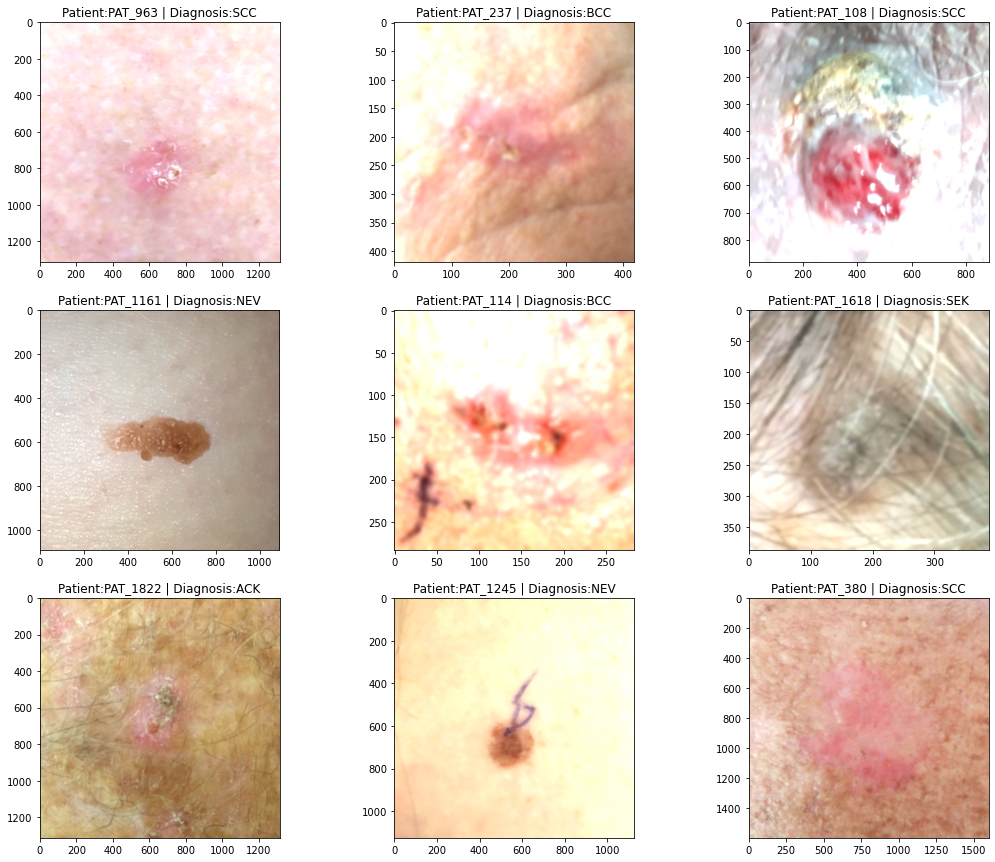

In [38]:
apply_processing_show_sample_pictures(df, enhance_contrast_ab, n_samples=9)

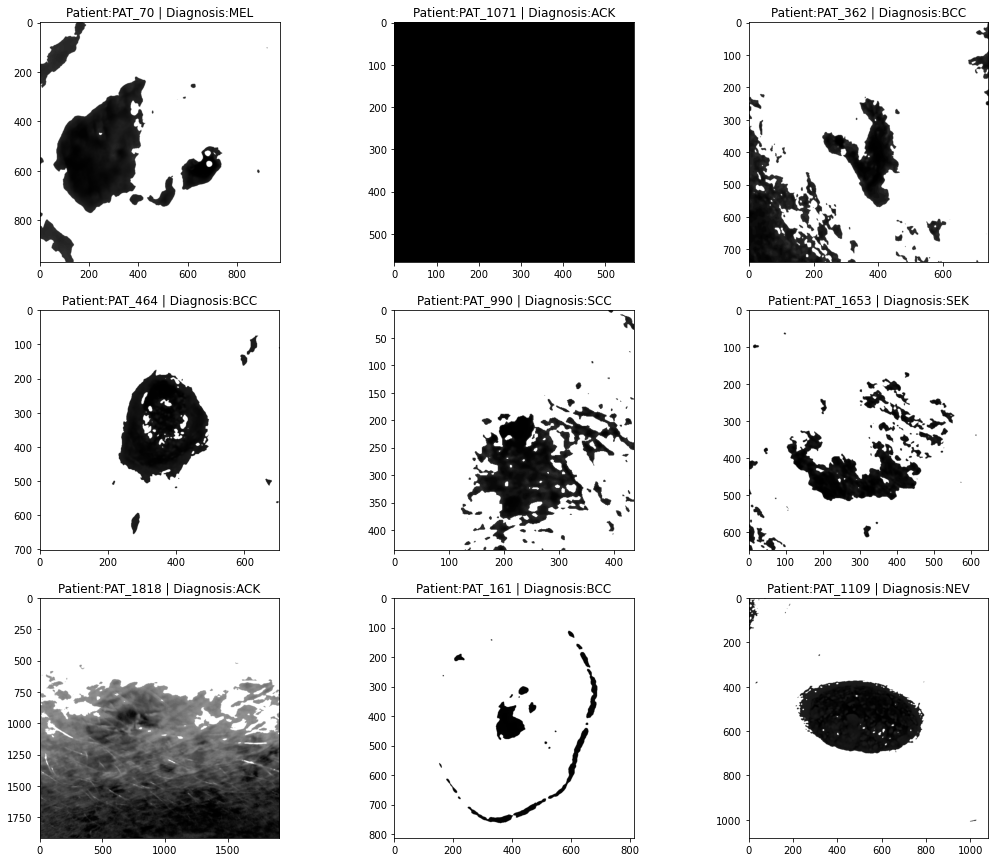

In [39]:
gray = apply_processing_show_sample_pictures(df, enhance_contrast_ab_gray, n_samples=9)

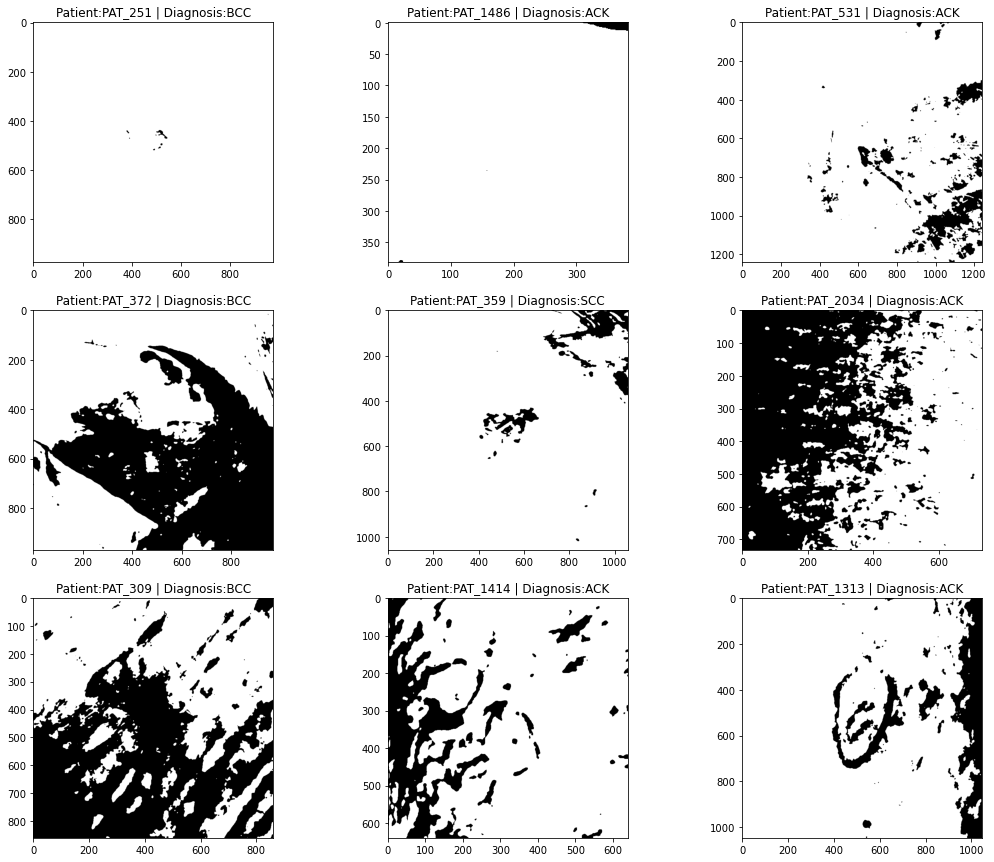

In [40]:
apply_processing_show_sample_pictures(df, apply_threshold, n_samples=9)

# The Beneficial Techniques in Preprocessing Step of Skin Cancer Detection System Comparing
https://www.researchgate.net/publication/269872765_The_Beneficial_Techniques_in_Preprocessing_Step_of_Skin_Cancer_Detection_System_Comparing

1. Color Space Transformation

Since LAB is one of the useful color
models which represent every color through three components of luminance, red/green and blue/yellow, it could be
beneficial to transform the RGB to LAB using XYZ as an intermediate colorspace. The luminance would present the
grayscale skin image 

2. Contrast Enhancement

Contrast enhancement is beneficial step to improve the perception for further processing; it can sharpen the image border
and improve the accuracy by accentuating the brightness difference between background and foreground. 


The widely practiced methods are classified into
“Linear contrast enhancement” and “Non-Linear contrast enhancement” techniques

**Linear contrast enhancement techniques:*** This type of contrast enhancement refers to contrast stretching techniques. The
image can be transformed to higher contrast by remapping or stretching the gray-level values so that histogram spread
over the full range 

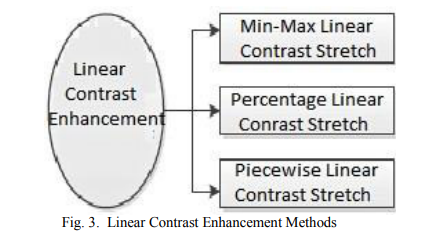

**Non- Linear contrast enhancement techniques:** This type of contrast enhancement mostly deals with histogram
equalizations and algorithms [16]. The most imperfection of such techniques is losing the correct brightness of an object
due to the multiple values of output image against each value in an input image [16]. In medical purposes, non-Linear
contrast enhancement techniques are commonly used 

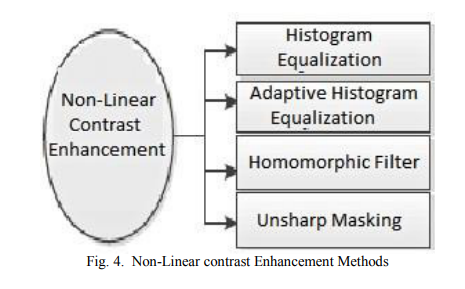

**Since in skin cancer detection systems, local details of melanoma are more essential t
han global, therefore, the Histogram
Equalization (HE), Adaptive histogram equalization (AHE), and Unsharp Masking as three well-known local enhancement
methods are more applicable in such diagnostic**

In [41]:
def preprocessing_lab_histeq(img):
        blur = cv2.GaussianBlur(img,(5,5),0)
        
        # https://stackoverflow.com/questions/39308030/how-do-i-increase-the-contrast-of-an-image-in-python-opencv
        lab= cv2.cvtColor(blur, cv2.COLOR_BGR2LAB)
        l_channel, a, b = cv2.split(lab)
        clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
        cl = clahe.apply(l_channel)
        limg = cv2.merge((cl,a,b))
        enhanced_img = cv2.cvtColor(limg, cv2.COLOR_LAB2BGR)
       
        return enhanced_img

In [42]:
def preprocessing_lab_histeq_gray(img):
        enhanced_img = preprocessing_lab_histeq(img)
        
        gray = cv2.cvtColor(enhanced_img, cv2.COLOR_BGR2GRAY )
        gray=cv2.equalizeHist(gray)
                
        return  gray

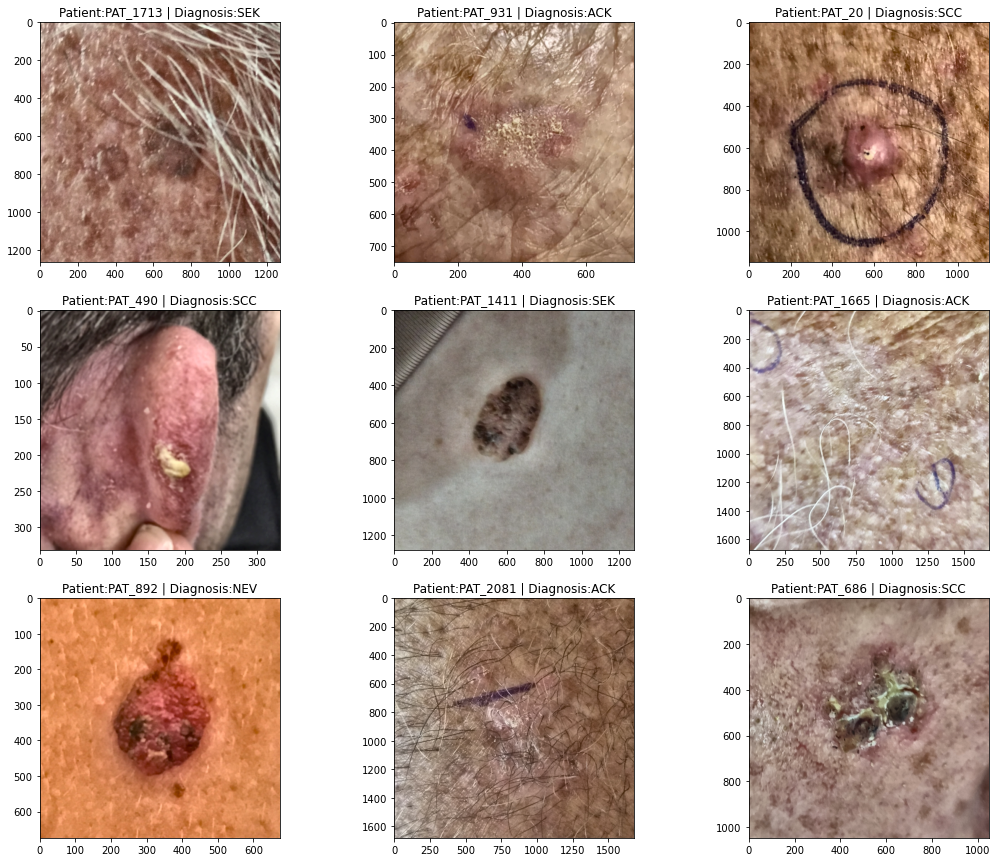

In [43]:
apply_processing_show_sample_pictures(df, preprocessing_lab_histeq, n_samples=9)

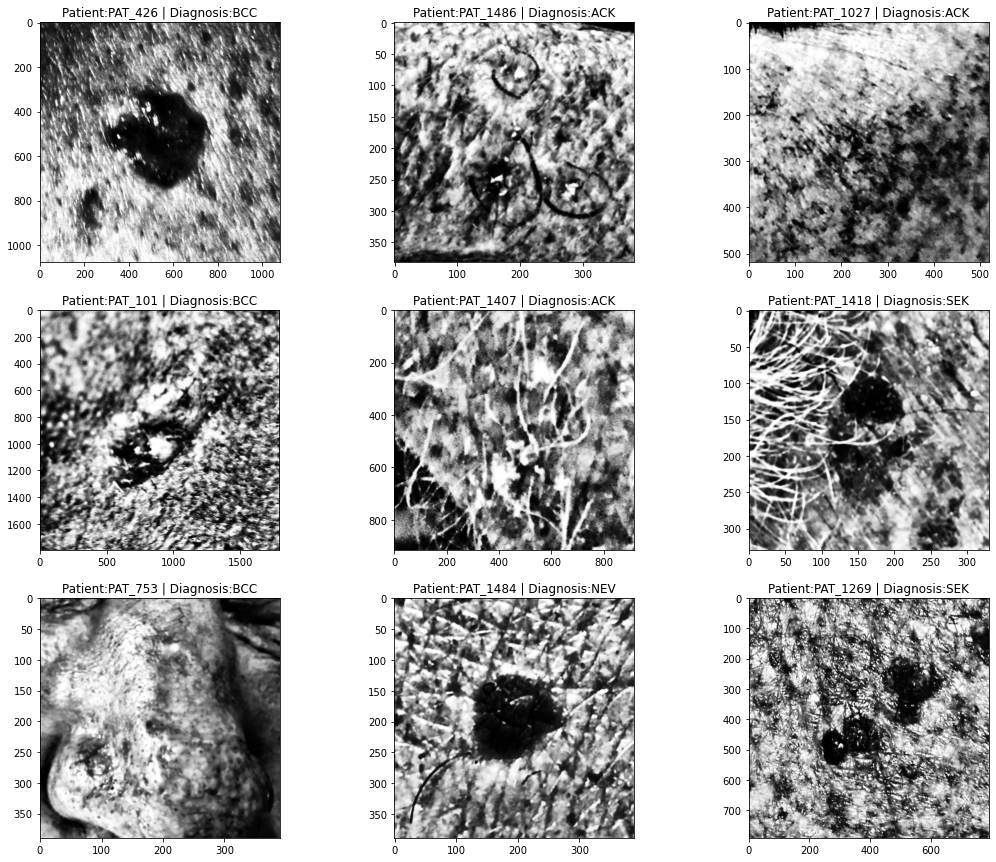

In [44]:
apply_processing_show_sample_pictures(df, preprocessing_lab_histeq_gray, n_samples=9)